# Introduction:

Lung cancer's impact on global health underscores the urgency of innovative diagnostic approaches. Integrating advanced medical imaging, radiomics, and machine learning offers new dimensions for understanding tumor behavior and guiding treatment. This analysis focuses on CT image feature analysis and machine learning prediction of non-small cell lung cancer (NSCLC), the most prevalent form of lung cancer.

## Objectives:
1. Radiomics Exploration: Investigate radiomic features from CT images to uncover hidden insights beyond visual assessment.

2. Machine Learning Prediction: Employ machine learning algorithms to build predictive models distinguishing benign and malignant tumors.

3. Tumor Behavior Prognosis: Correlate radiomic patterns with tumor aggressiveness to facilitate better prognostication.

## Methodology:

* Data Collection: Gather a diverse dataset of CT images containing benign lung tumors and NSCLC cases.

* Feature Extraction: Quantify radiomic features like texture, shape, and intensity from the CT images.

* Model Development: Utilize machine learning techniques to develop predictive models based on the extracted radiomic features.

* Validation: Validate the models using appropriate evaluation metrics and cross-validation techniques.

## Results:

Radiomic Insights: Unveil previously unseen correlations between radiomic features and tumor characteristics.

Prediction Accuracy: Assess the accuracy of the developed models in distinguishing between benign and malignant tumors.

Behavioral Patterns: Identify radiomic patterns that correlate with tumor behavior and prognosis.


## Libraries and Packages

In [9]:
import os
import cv2
import math
import random
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg


# Data

<b>Benign Lung Tumor Dataset</b>

The **Benign Lung Tumor** dataset contains a collection of images and associated data related to patients with benign lung tumors. Benign tumors are non-cancerous growths that do not spread to other parts of the body. These tumors are generally less aggressive and have a lower likelihood of causing serious harm. In this dataset, each subfolder corresponds to a patient's case, and within each patient's folder, there are medical images.

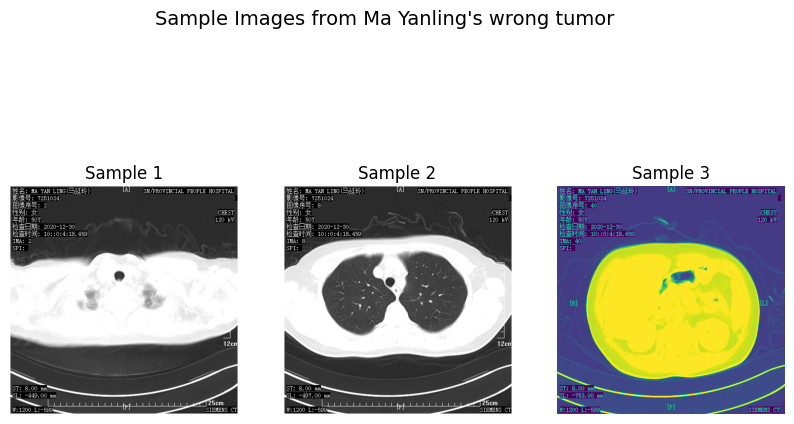

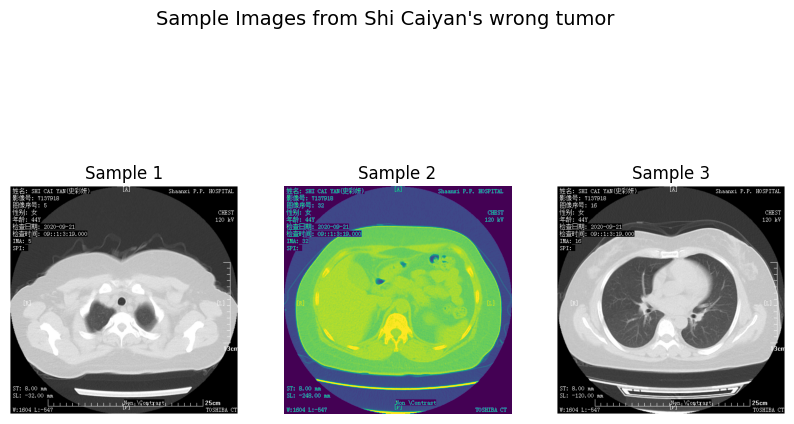

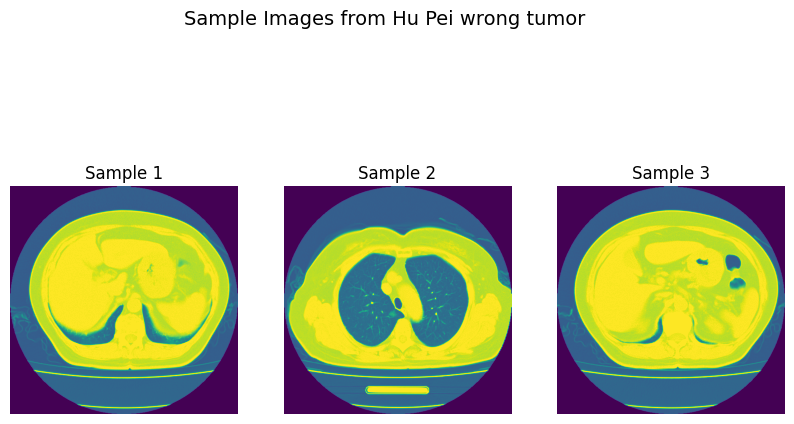

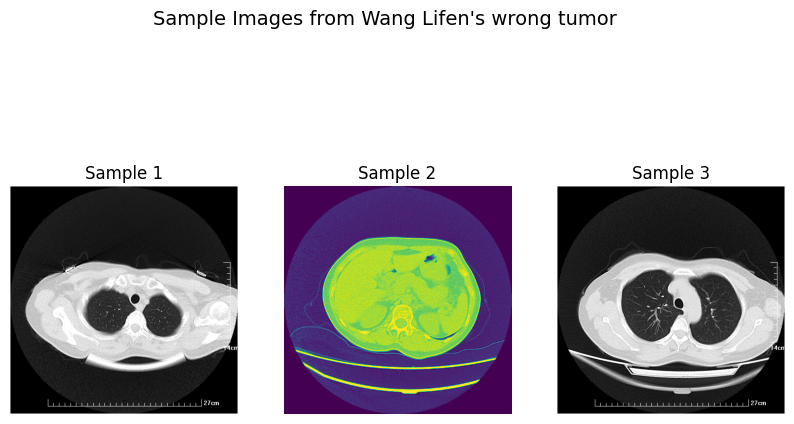

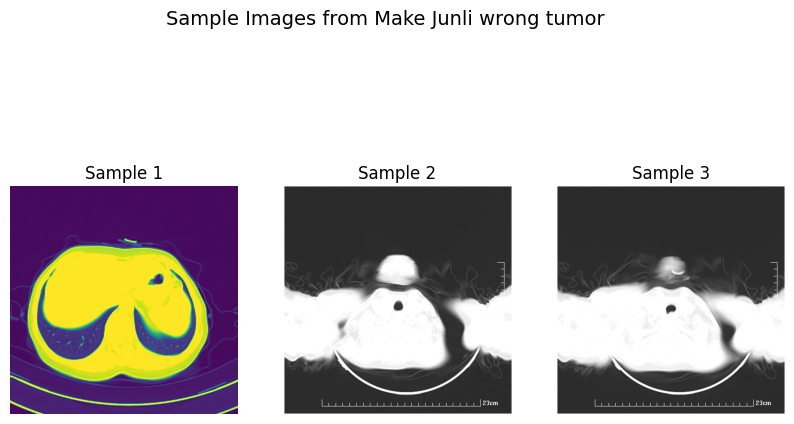

...

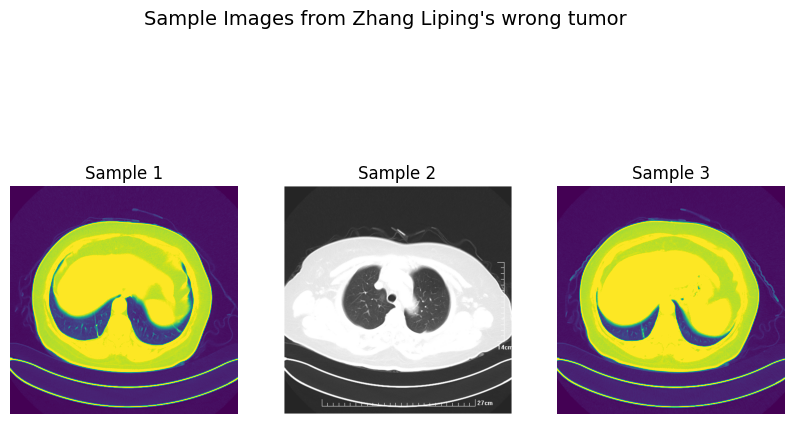

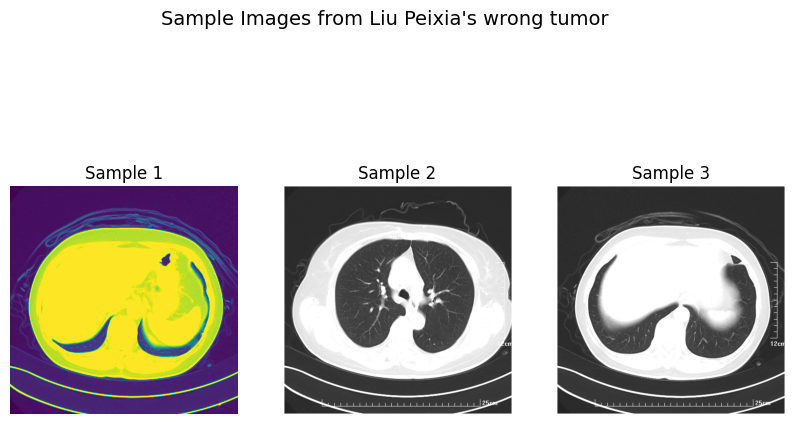

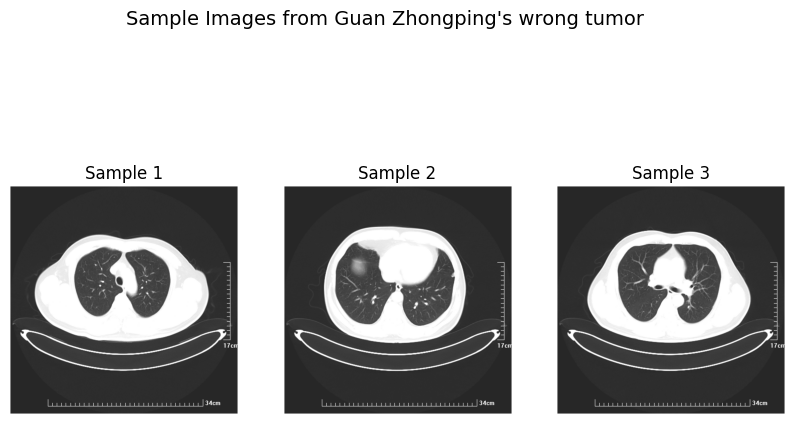

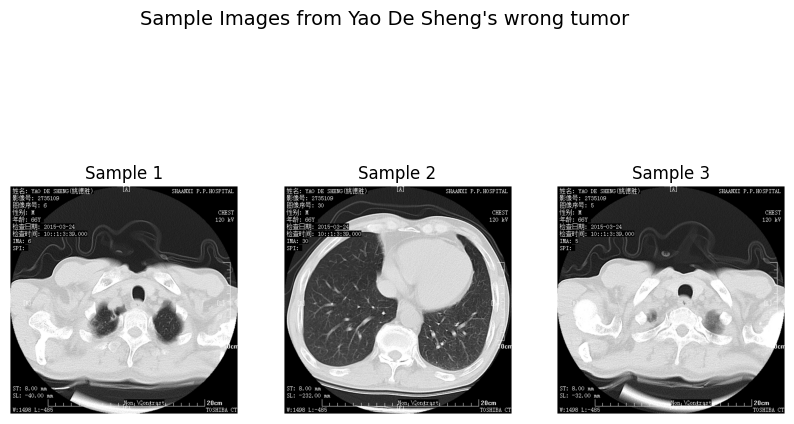

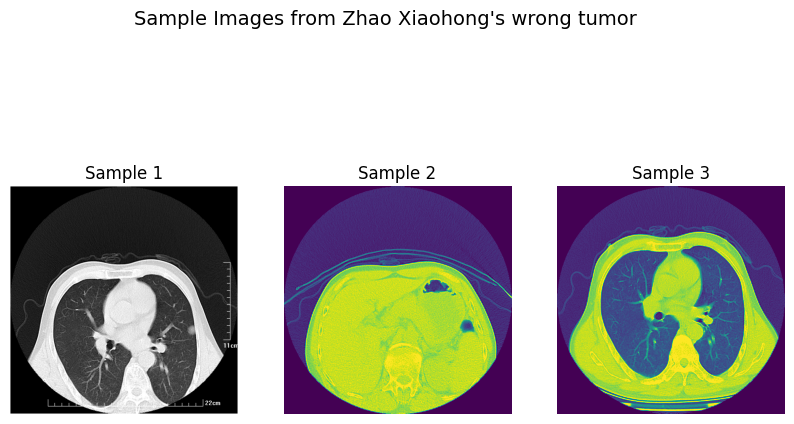

In [6]:
benign_data_root = "./Data/BenignLungTumor"

subfolders = os.listdir(benign_data_root)
num_samples_per_subfolder = 3

for subfolder in subfolders:
    subfolder_path = os.path.join(benign_data_root, subfolder)
    if os.path.isdir(subfolder_path):
        image_files = [f for f in os.listdir(subfolder_path) if f.endswith(".bmp")]
        sample_images = image_files[:num_samples_per_subfolder]
        
        plt.figure(figsize=(10, 6))
        plt.suptitle(f"Sample Images from {subfolder}", fontsize=14)
        
        for i, image_filename in enumerate(sample_images):
            image_path = os.path.join(subfolder_path, image_filename)
            image = mpimg.imread(image_path)
            
            plt.subplot(1, num_samples_per_subfolder, i + 1)
            plt.imshow(image)
            plt.title(f"Sample {i + 1}")
            plt.axis("off")
        
        plt.show()


<b>Lung Cancer Dataset</b>

The **Lung Cancer** dataset consists of images and information about patients diagnosed with lung cancer. Lung cancer is a malignant tumor that starts in the lungs and can potentially spread to other parts of the body. This type of cancer can be more aggressive and poses a greater health risk. Similar to the benign tumor dataset, the lung cancer dataset is organized into subfolders, each representing a different patient's case.

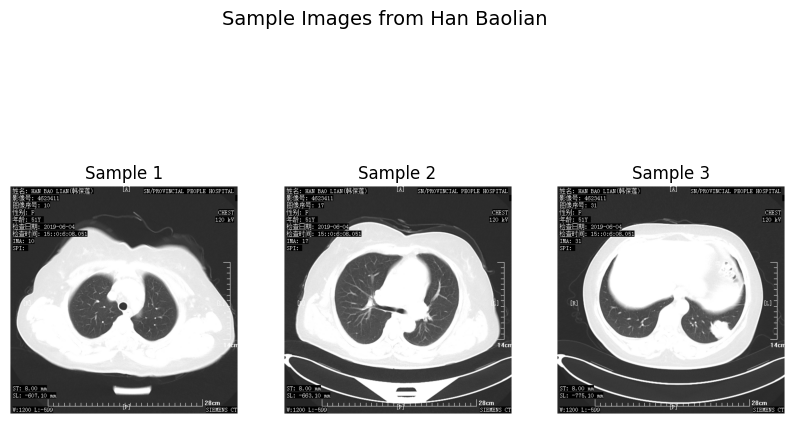

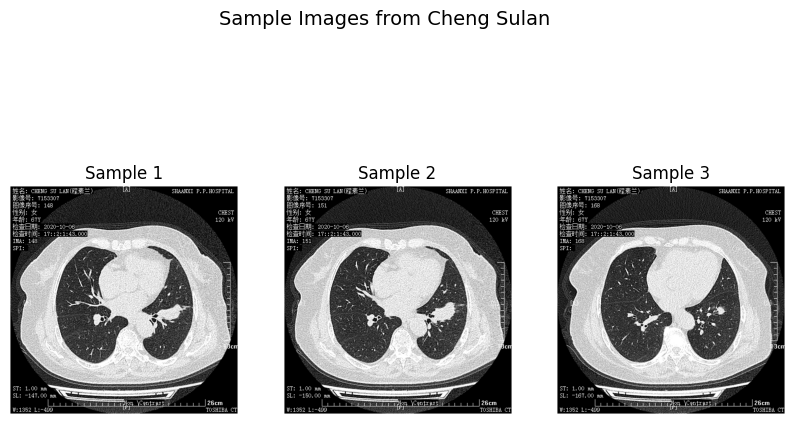

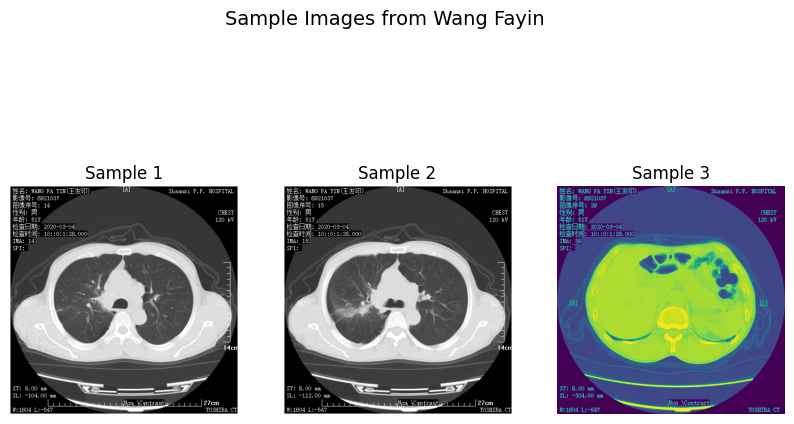

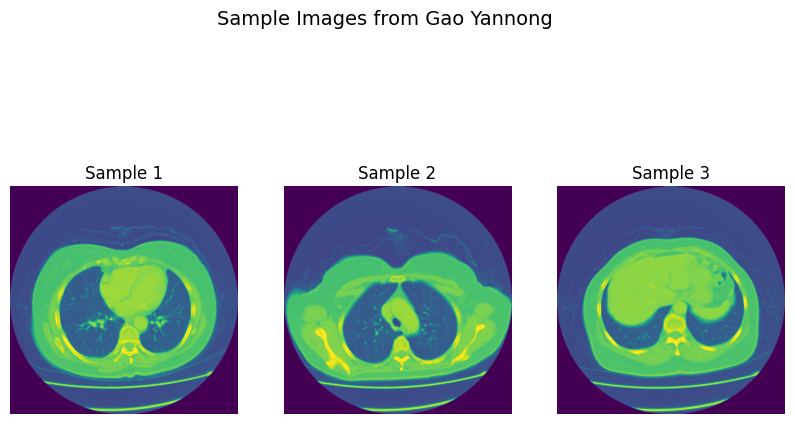

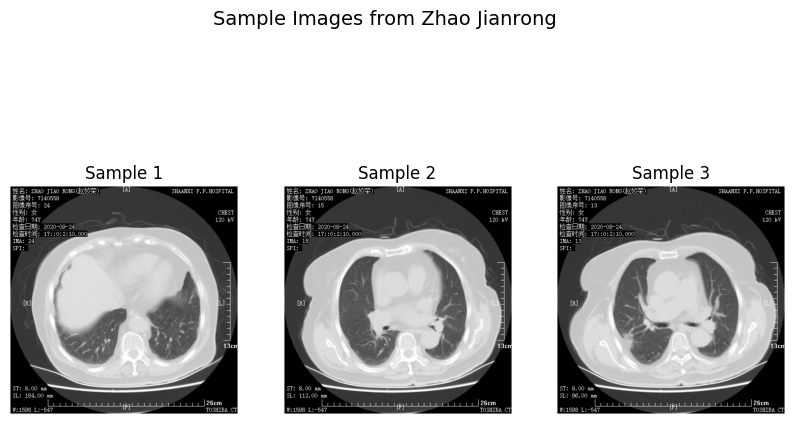

...

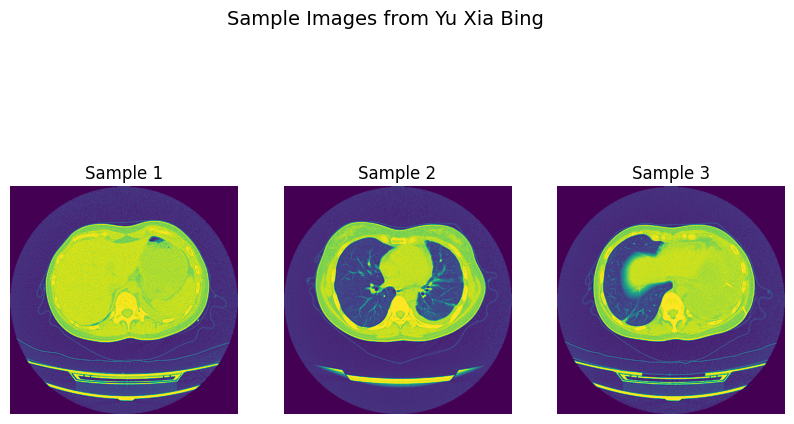

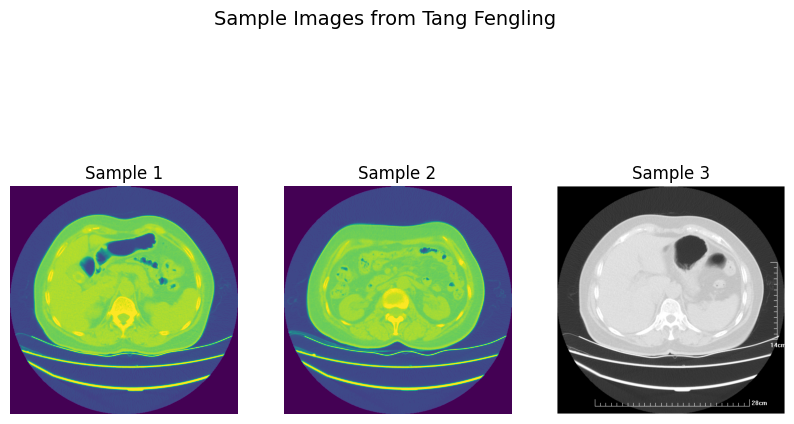

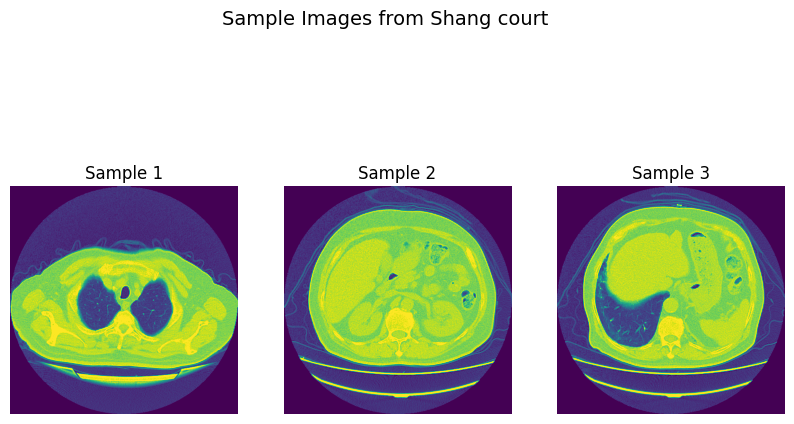

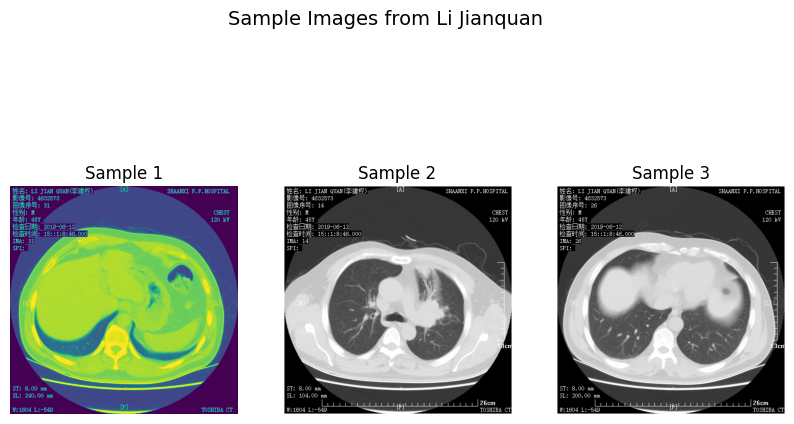

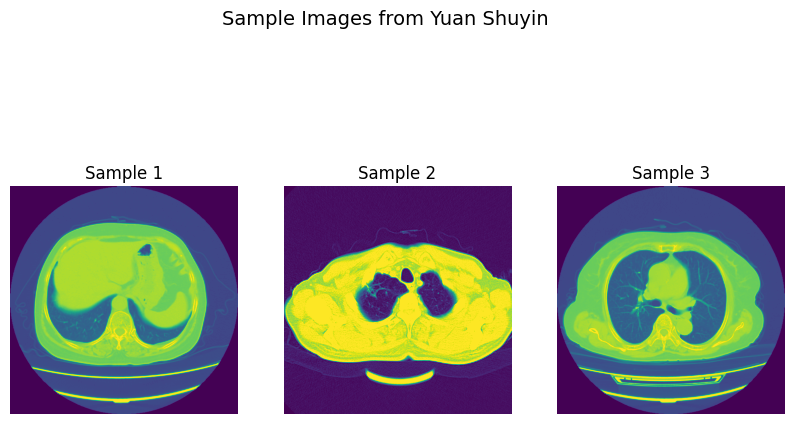

<Figure size 1000x600 with 0 Axes>

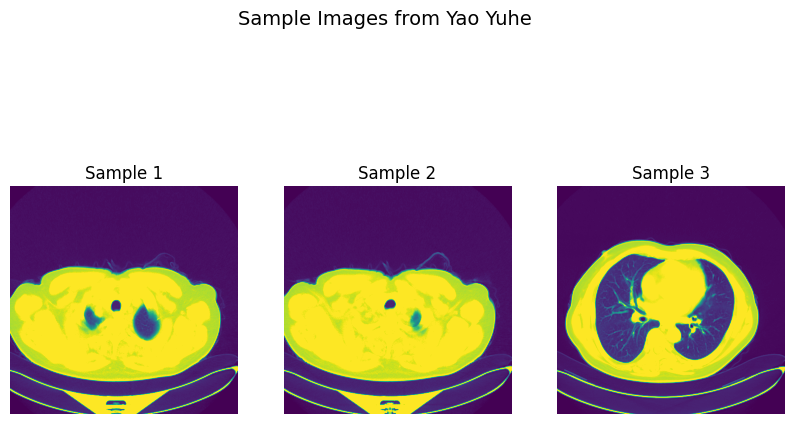

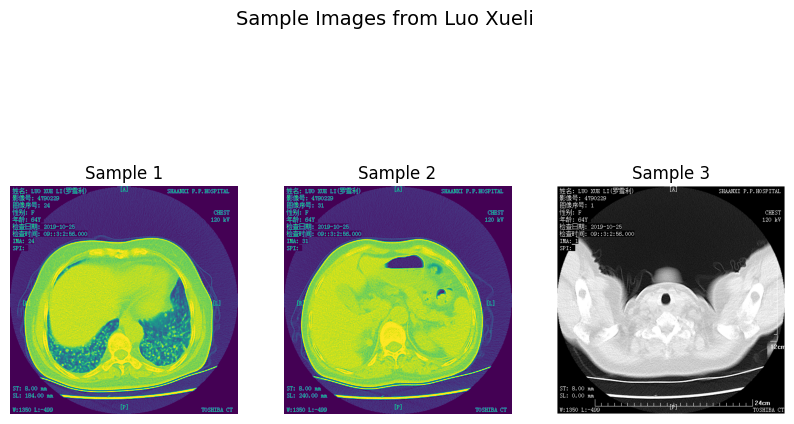

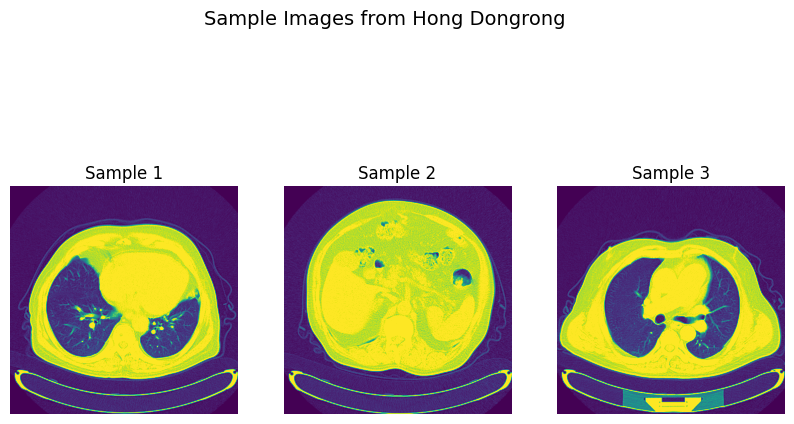

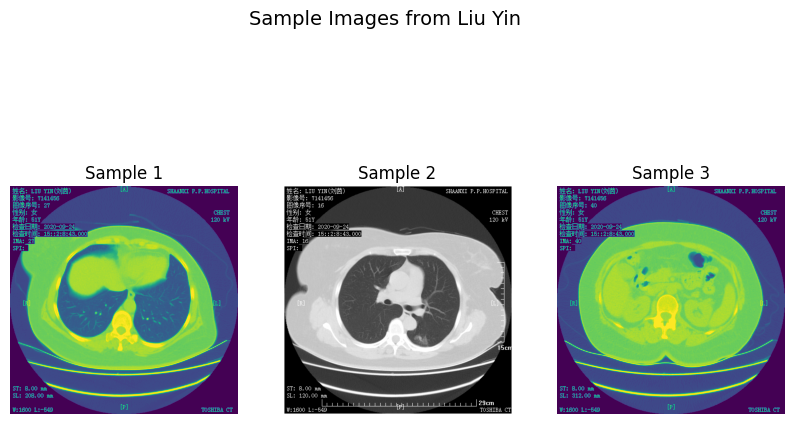

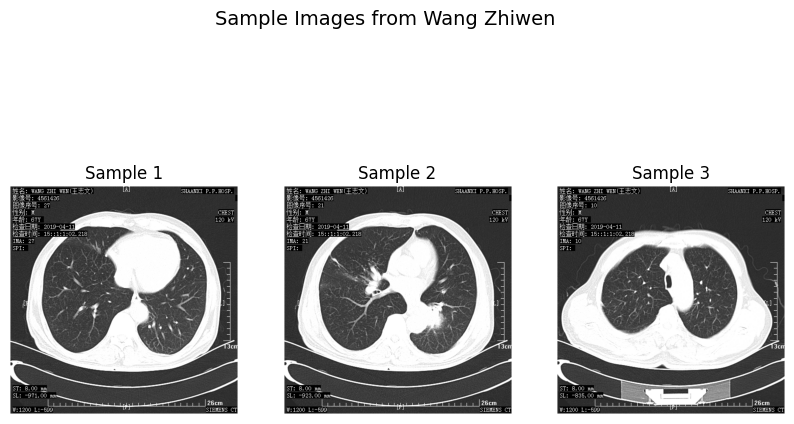

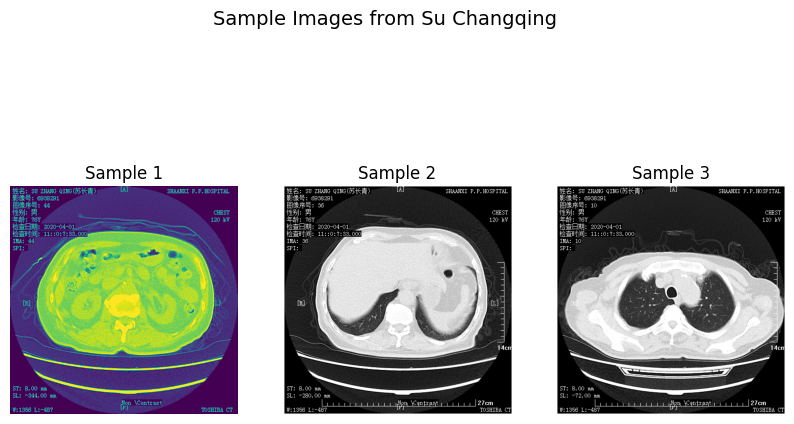

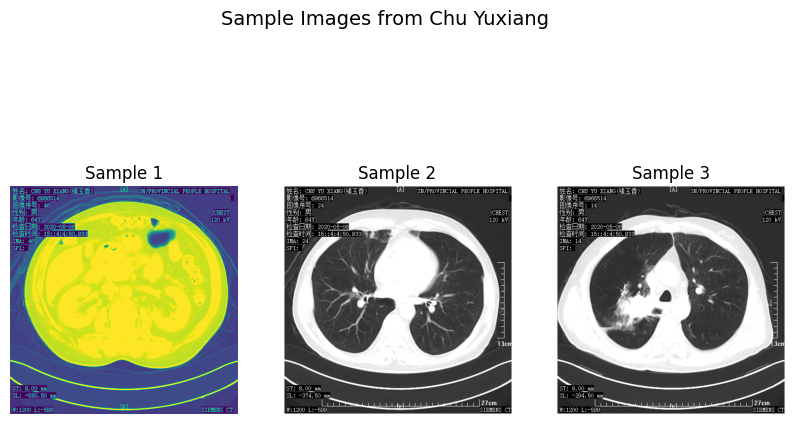

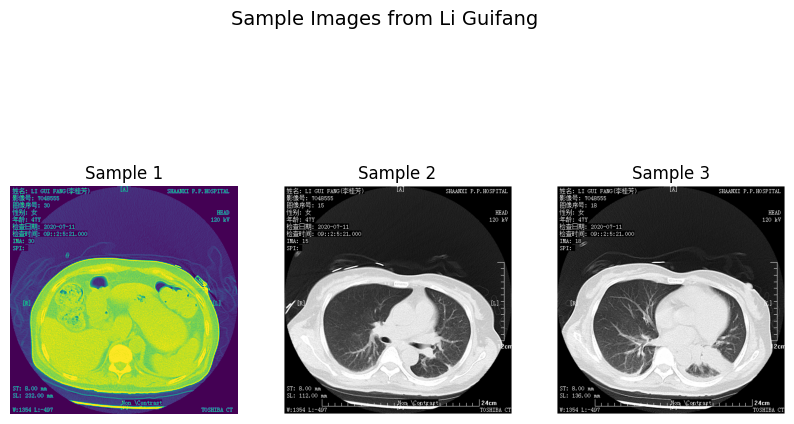

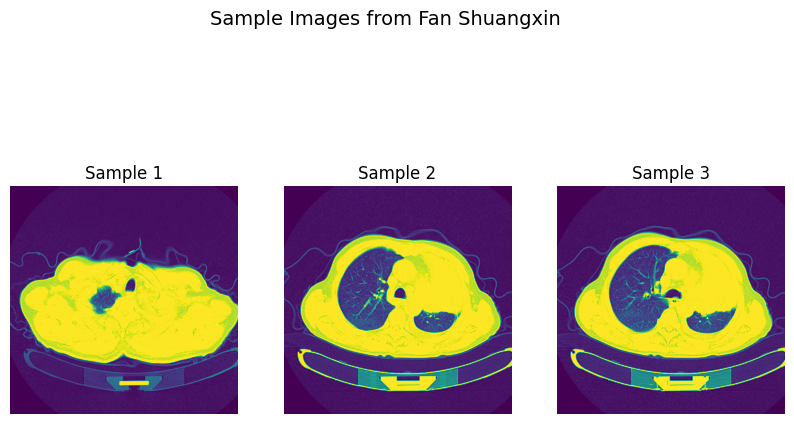

<Figure size 1000x600 with 0 Axes>

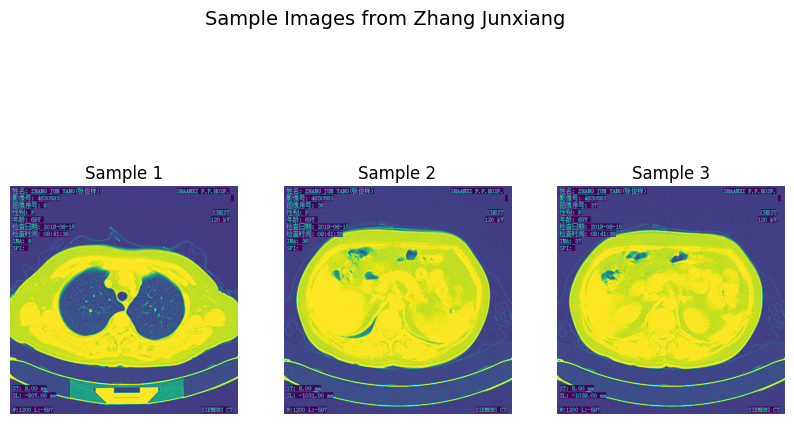

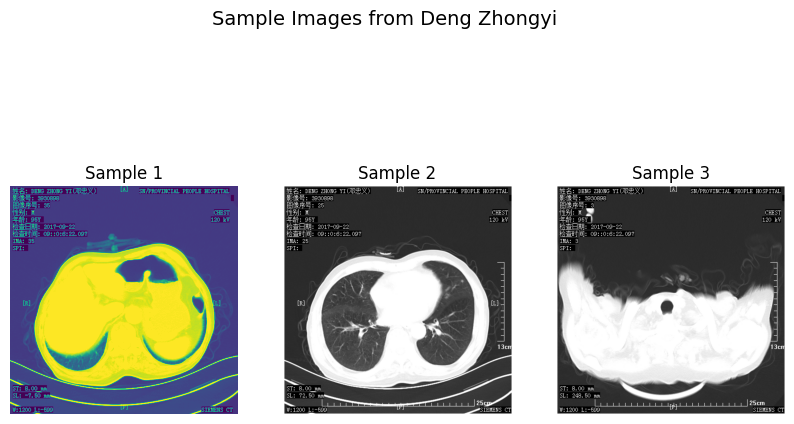

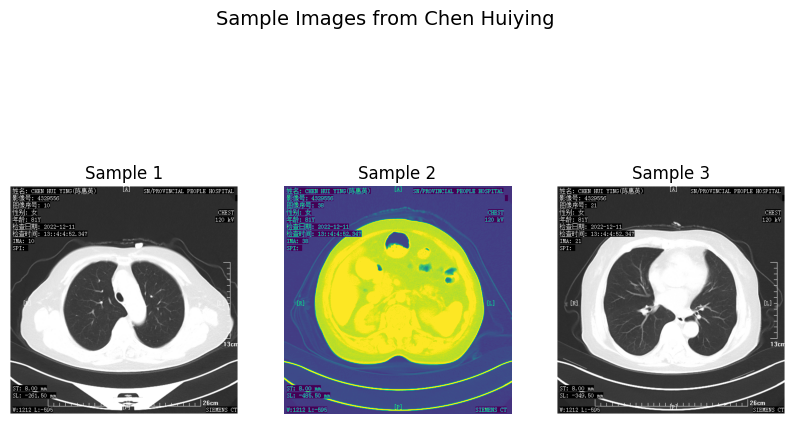

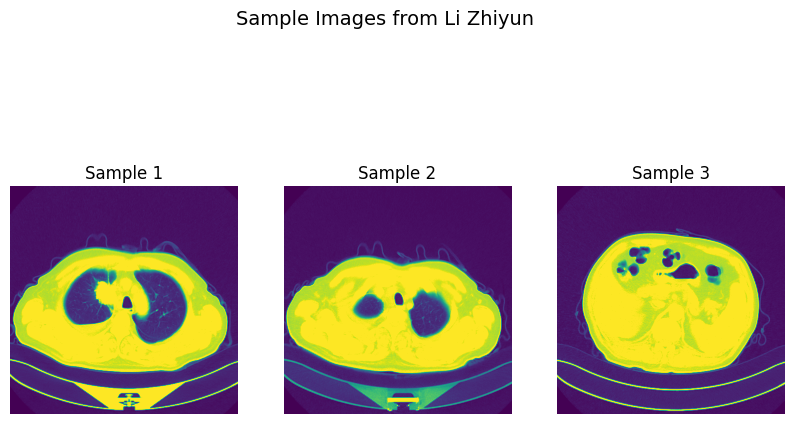

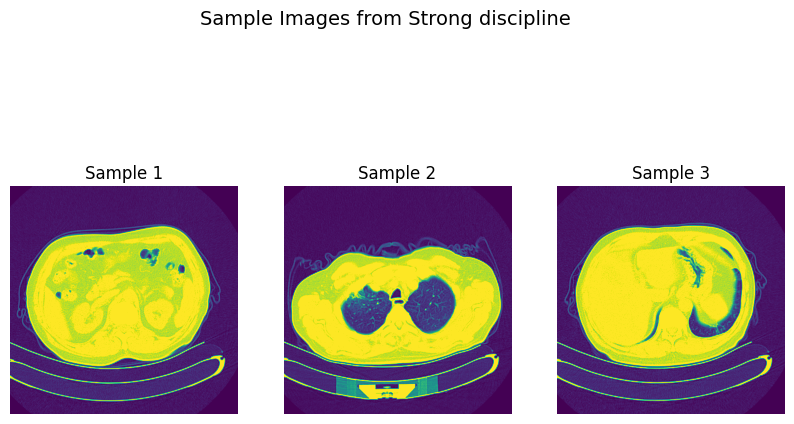

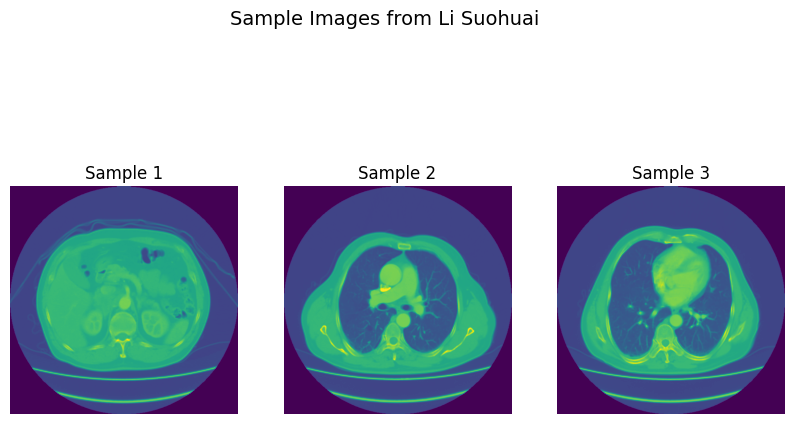

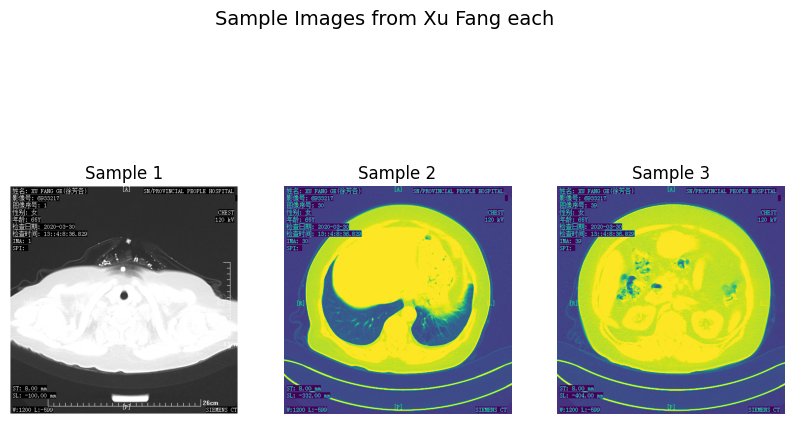

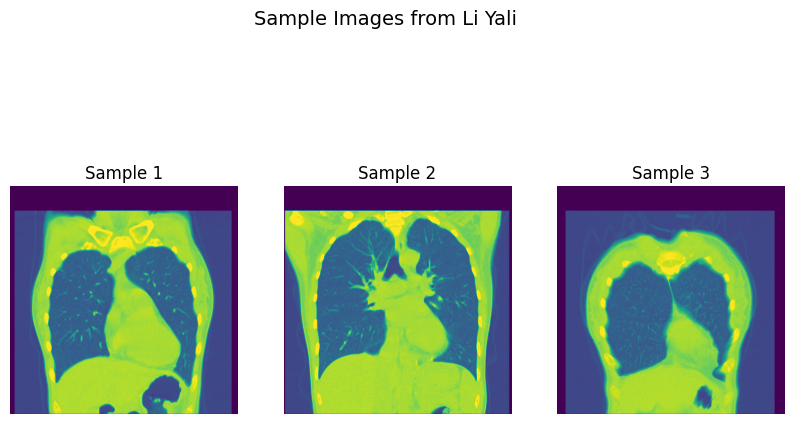

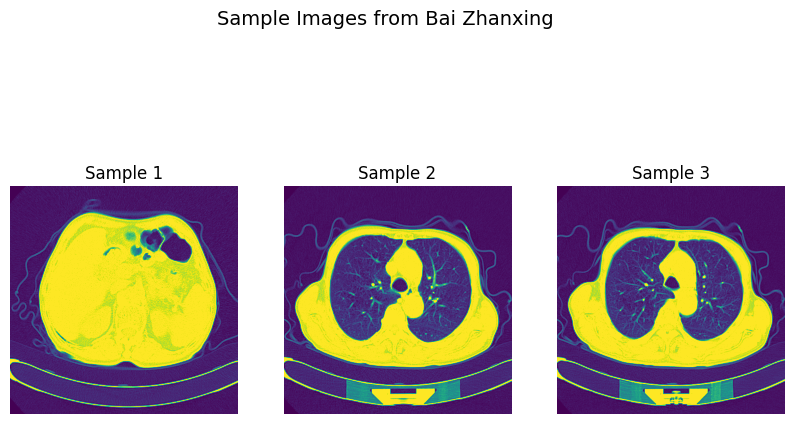

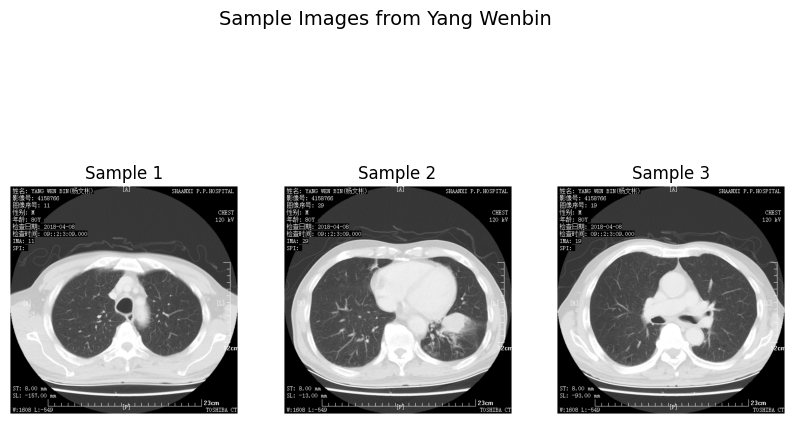

<Figure size 1000x600 with 0 Axes>

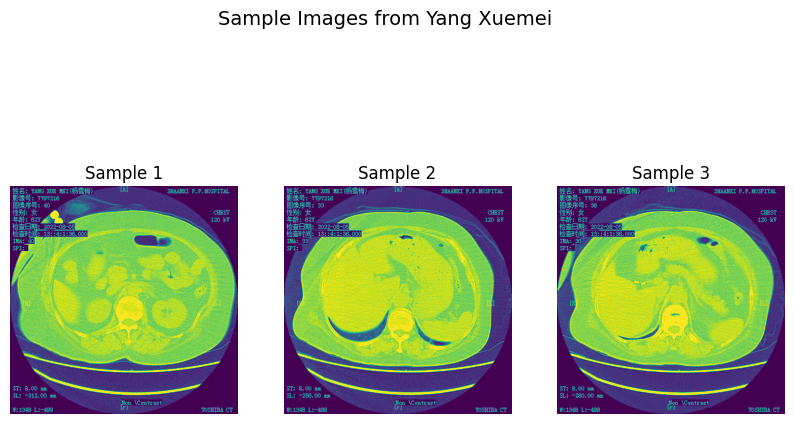

<Figure size 1000x600 with 0 Axes>

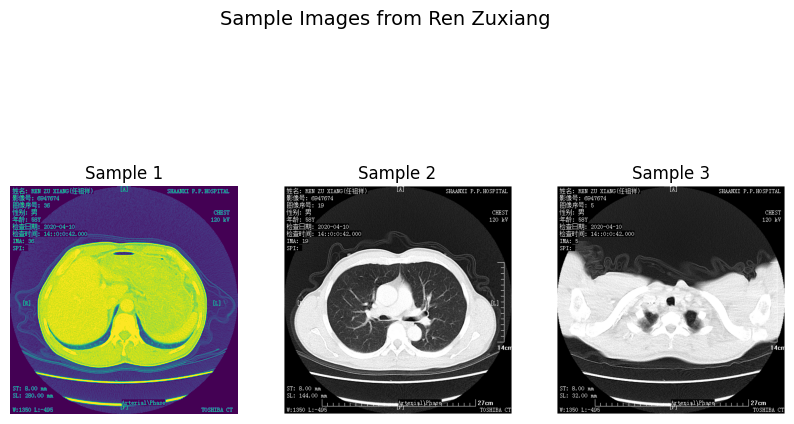

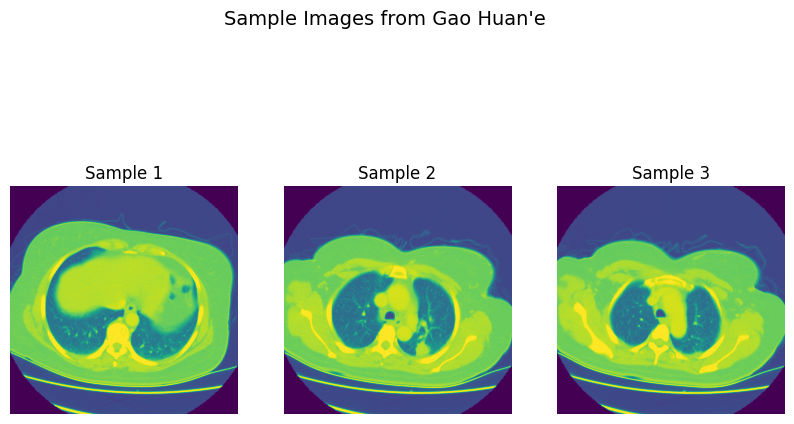

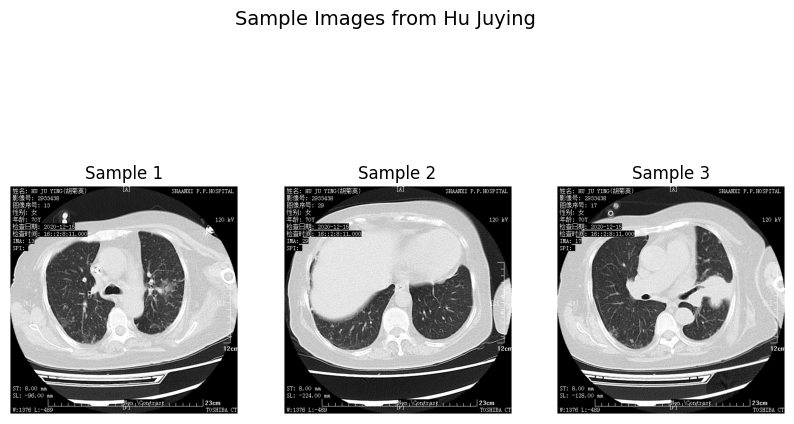

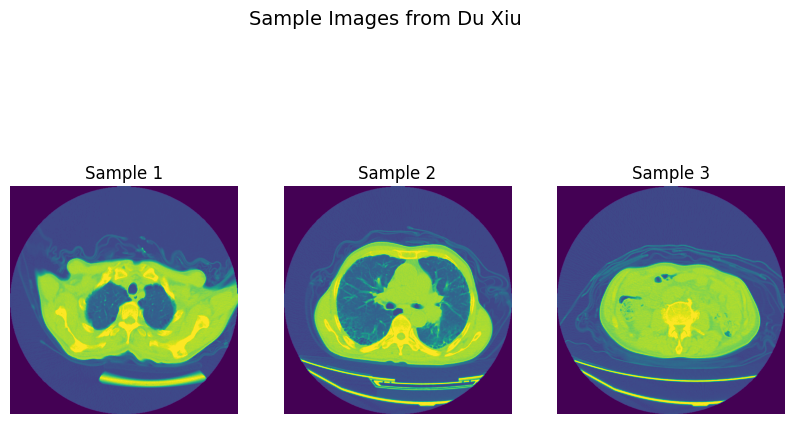

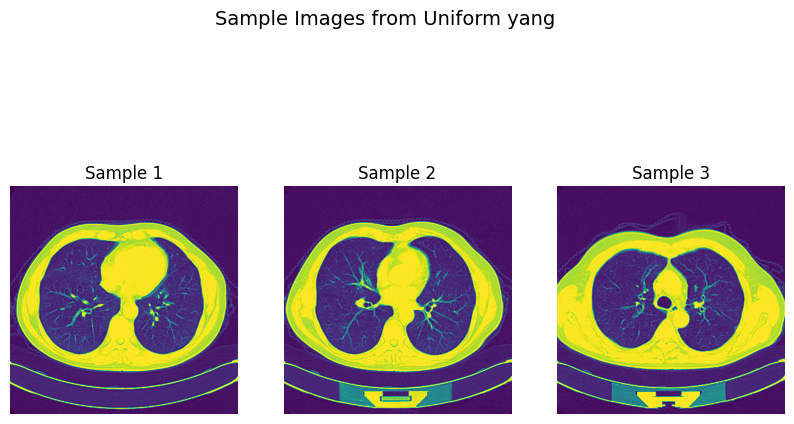

...

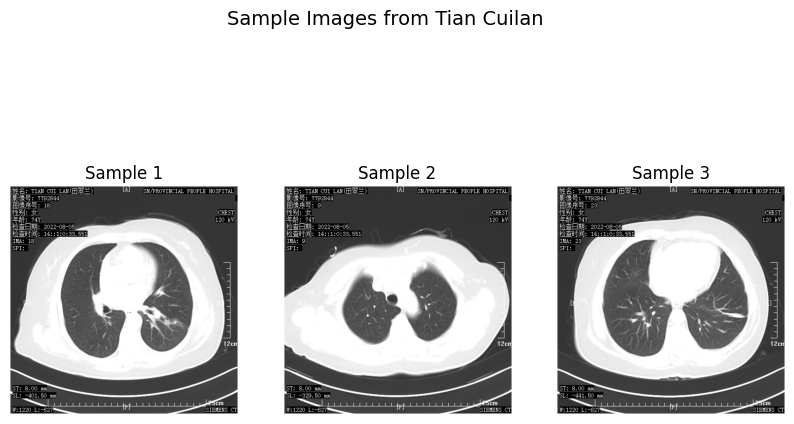

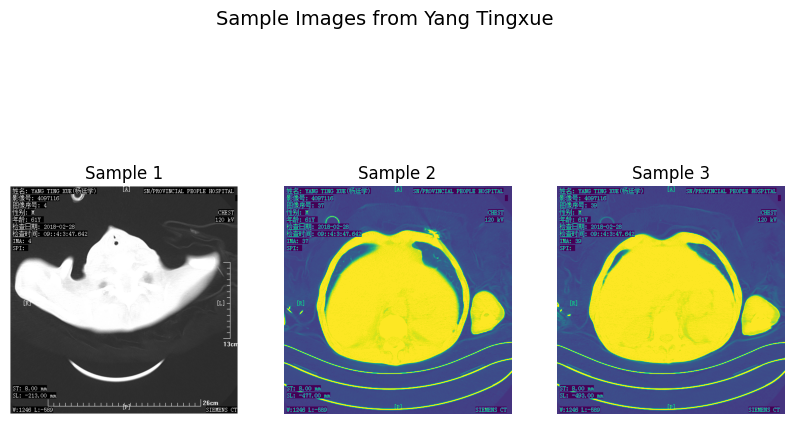

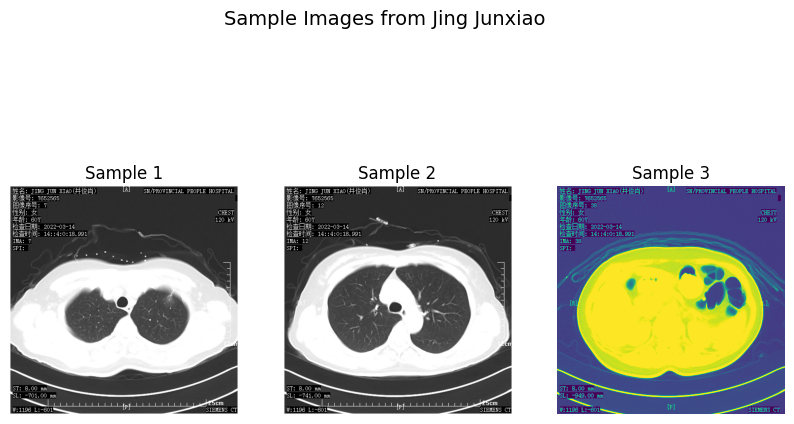

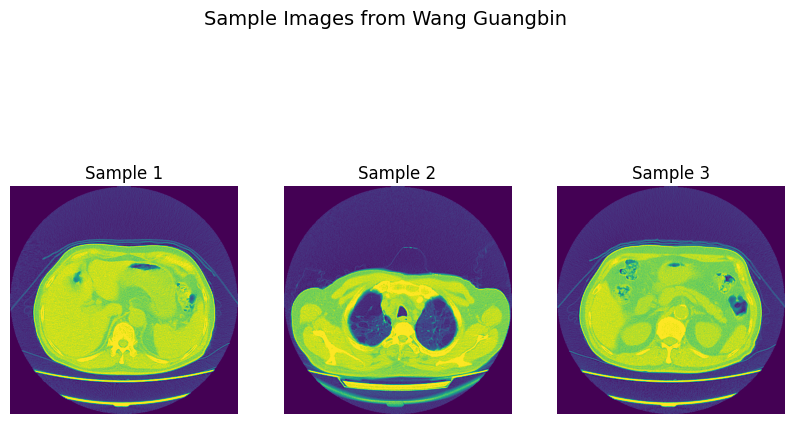

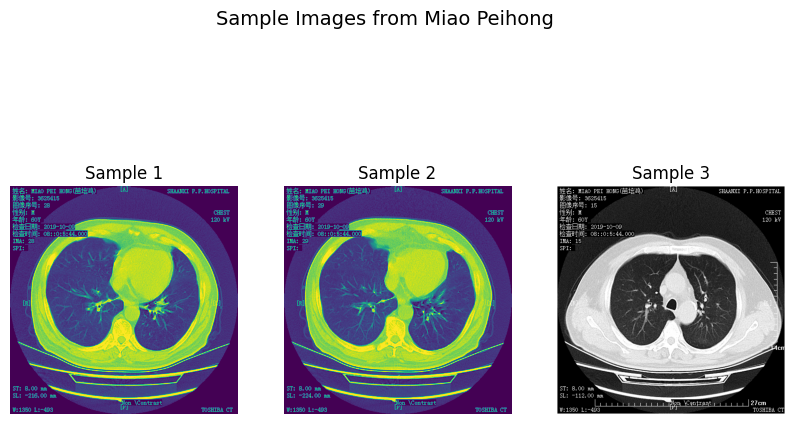

<Figure size 1000x600 with 0 Axes>

In [5]:
feiai_data = "./Data/LungCancer/Feiai"
subfolders = os.listdir(feiai_data)
num_samples_per_subfolder = 3

for subfolder in subfolders:
    subfolder_path = os.path.join(feiai_data, subfolder)
    if os.path.isdir(subfolder_path):
        image_files = [f for f in os.listdir(subfolder_path) if f.endswith(".bmp")]
        sample_images = image_files[:num_samples_per_subfolder]
        
        plt.figure(figsize=(10, 6))
        plt.suptitle(f"Sample Images from {subfolder}", fontsize=14)
        
        for i, image_filename in enumerate(sample_images):
            image_path = os.path.join(subfolder_path, image_filename)
            image = mpimg.imread(image_path)
            
            plt.subplot(1, num_samples_per_subfolder, i + 1)
            plt.imshow(image)
            plt.title(f"Sample {i + 1}")
            plt.axis("off")
        
        plt.show()


# EDA

<b>Average Images Analysis</b>

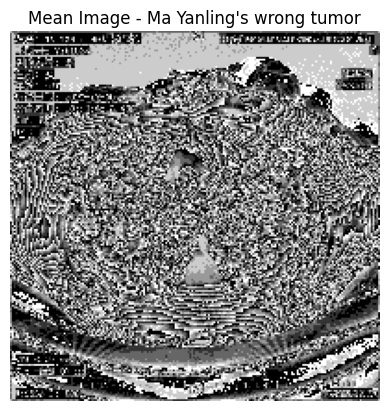

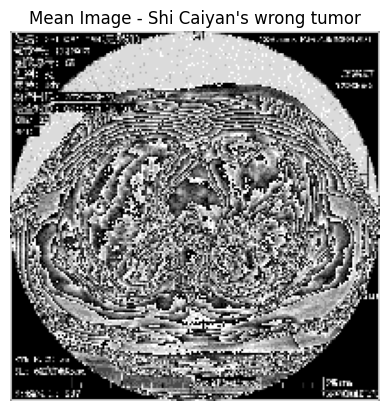

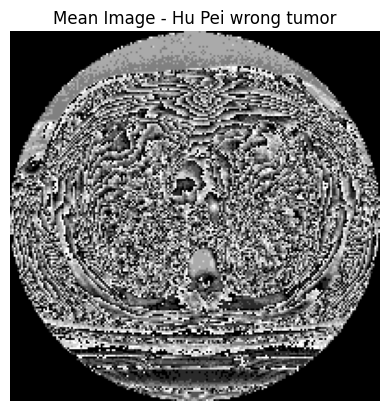

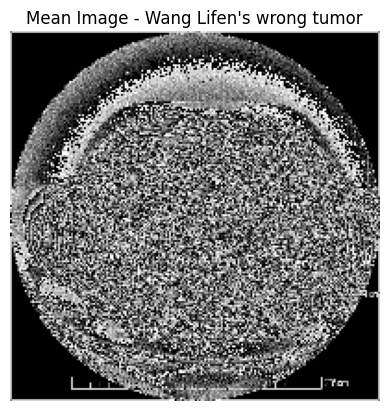

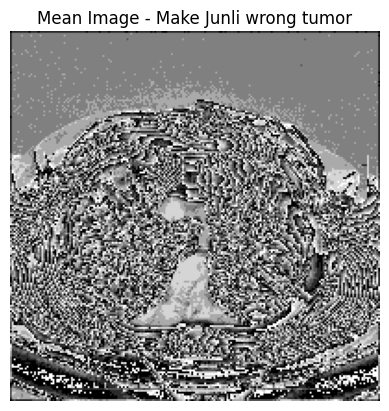

...

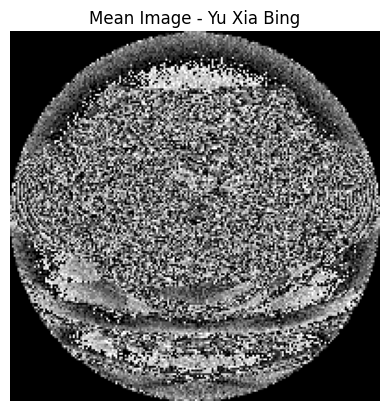

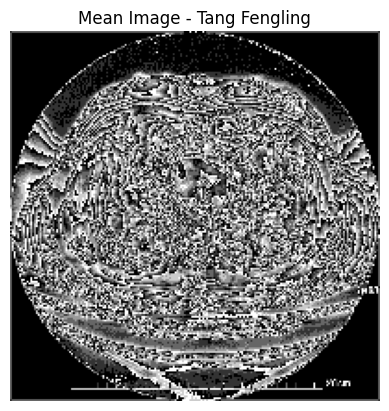

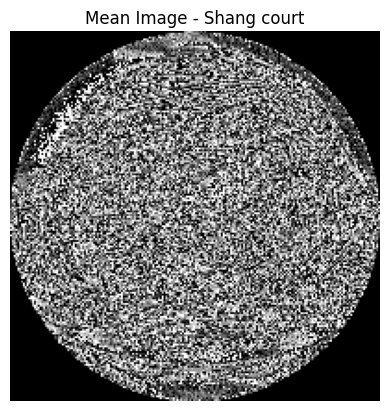

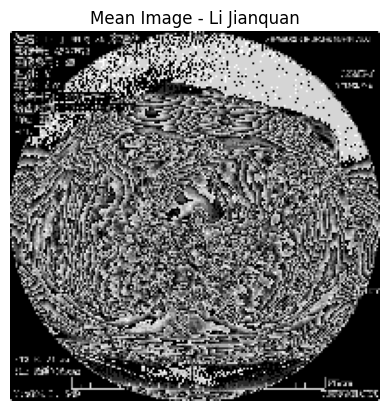

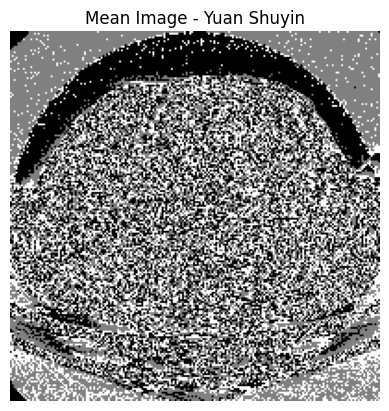

/home/milo/.local/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/milo/.local/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/milo/.local/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in cast
  ret = ret.dtype.type(ret / rcount)


TypeError: Invalid shape () for image data

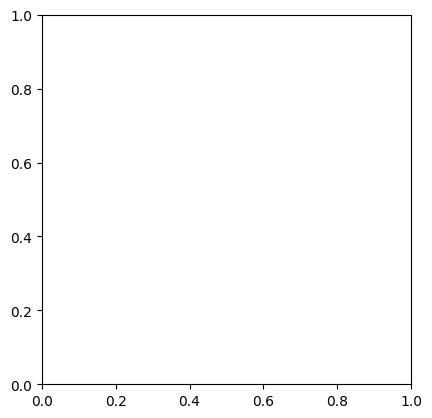

In [19]:
# Function to load and resize images
def load_and_resize_images(folder_path, target_size):
    image_files = [filename for filename in os.listdir(folder_path) if filename.endswith(".bmp")]
    images = [cv2.imread(os.path.join(folder_path, filename), cv2.IMREAD_GRAYSCALE) for filename in image_files]
    resized_images = [cv2.resize(img, target_size) for img in images]
    return resized_images

# Specify the paths to the folders containing images
benign_data_folder = benign_data_root
lung_cancer_folder = feiai_data

# Load and resize images for each patient in the benign dataset
target_size = (200, 200)
benign_patient_folders = [folder for folder in os.listdir(benign_data_folder) if os.path.isdir(os.path.join(benign_data_folder, folder))]
for patient_folder in benign_patient_folders:
    patient_path = os.path.join(benign_data_folder, patient_folder)
    resized_images = load_and_resize_images(patient_path, target_size)
    mean_image = np.mean(resized_images, axis=0, dtype=np.uint8)
    
    plt.imshow(mean_image, cmap='gray')
    plt.title(f"Mean Image - {patient_folder}")
    plt.axis("off")
    plt.show()

# Load and resize images for each patient in the lung cancer dataset
lung_cancer_patient_folders = [folder for folder in os.listdir(lung_cancer_folder) if os.path.isdir(os.path.join(lung_cancer_folder, folder))]
for patient_folder in lung_cancer_patient_folders:
    patient_path = os.path.join(lung_cancer_folder, patient_folder)
    resized_images = load_and_resize_images(patient_path, target_size)
    mean_image = np.mean(resized_images, axis=0, dtype=np.uint8)
    
    plt.imshow(mean_image, cmap='gray')
    plt.title(f"Mean Image - {patient_folder}")
    plt.axis("off")
    plt.show()


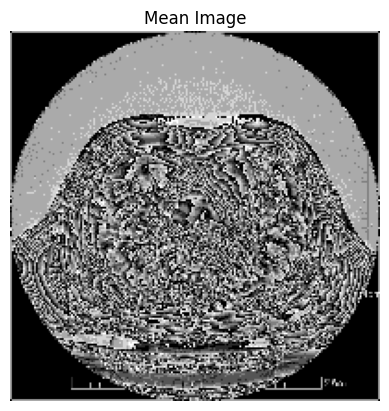

In [18]:
# Function to load and resize images
def load_and_resize_images(folder_path, target_size):
    image_files = [filename for filename in os.listdir(folder_path) if filename.endswith(".bmp")]
    images = [cv2.imread(os.path.join(folder_path, filename), cv2.IMREAD_GRAYSCALE) for filename in image_files]
    resized_images = [cv2.resize(img, target_size) for img in images]
    return resized_images

# Specify the path to the folder containing images
image_folder = "./Data/BenignLungTumor/Ai Aizhu Erochemical Tumor/"

# Load and resize images
target_size = (200, 200)
resized_images = load_and_resize_images(image_folder, target_size)

# Calculate the mean image
mean_image = np.mean(resized_images, axis=0, dtype=np.uint8)

# Display the mean image
plt.imshow(mean_image, cmap='gray')
plt.title("Mean Image")
plt.axis("off")
plt.show()


The resulting average images provide a visual representation of the typical characteristics found in the dataset. While these images may not represent any specific individual's condition, they give us a general idea of the common features shared among the images in each dataset.

For the "Benign Lung Tumor" dataset, the average image highlights the common patterns and structures present in benign tumor images. Similarly, the "Lung Cancer" dataset's average image provides insights into the common features observed in lung cancer images.

Interpretation
Interpreting the average images involves analyzing the intensity patterns and shapes that stand out. By comparing these average images with individual patient images, we can identify deviations from the norm that might indicate unique cases or anomalies. However, it's essential to note that these average images are more of a representation of the overall dataset and may not capture every nuance present in individual patient images.